In [85]:
# notebook formatter
import jupyter_black

jupyter_black.load()

In [86]:
import os
import glob
import itertools
import pandas as pd
from scegot import scEGOT

In [87]:
DATASET_INPUT_ROOT_PATH = os.path.join(os.getcwd(), "dataset/input/")

In [88]:
RANDOM_STATE = 2022
PCA_N_COMPONENTS = 30
GMM_CLUSTER_NUMBERS = [1, 2, 4, 5, 5]
UMAP_N_NEIGHBORS = 1000
UMAP_N_COMPONENTS = 2
DAY_NAMES = ["day 0", "day 0.5", "day 1", "day 1.5", "day 2"]

In [89]:
input_file_paths = sorted(glob.glob(f"{DATASET_INPUT_ROOT_PATH}usedataSmall/*.csv"))
input_data = [
    pd.read_csv(input_file_path, index_col=0) for input_file_path in input_file_paths
]
print(f"number of days: {len(input_data)}")
print("shape of each day's data:")
for i, data in enumerate(input_data):
    print(f"    {DAY_NAMES[i]}: {data.shape}")
print("data example: ")
input_data[0].head()

number of days: 5
shape of each day's data:
    day 0: (4943, 2000)
    day 0.5: (1981, 2000)
    day 1: (551, 2000)
    day 1.5: (2562, 2000)
    day 2: (1753, 2000)
data example: 


,APOA1,ACTC1,CST1,KRT19,CALCB,GAL,CRH,APOA2,PLA2G2A,CTSV,...,PRICKLE1,RPL39L,PRR13,SYNE2,LOX,BTG2,FXYD4,YY1,AKR1D1,ZFHX3
iM_AAACCCACAACAACAA-1,0,5,0,23,0,105,0,0,0,9,...,2,18,4,11,0,0,0,17,0,0
iM_AAACGAAAGCTAGTTC-1,1,21,0,28,1,37,0,0,0,11,...,1,14,9,3,0,4,0,15,0,2
iM_AAACGAATCCTGCCAT-1,0,1,0,15,0,236,0,0,0,6,...,0,14,8,3,0,1,0,9,0,2
iM_AAACGAATCGACGATT-1,0,31,1,9,0,18,0,0,0,9,...,1,5,9,6,0,0,0,13,0,1
iM_AAACGAATCGCGGTAC-1,0,18,0,5,0,61,0,0,0,2,...,0,8,5,2,0,0,0,5,0,0


In [90]:
tf_gene_names = (
    pd.read_csv(
        f"{DATASET_INPUT_ROOT_PATH}TF_genes/TFgenes_name.csv", header=None, index_col=0
    )
    .T["cell"]
    .values
)
tf_gene_names

array(['ZBTB8B', 'GSX2', 'TBX2', ..., 'NME2', 'ZNF488', 'ZNF280B'],
      dtype=object)

# Tutorial

In [282]:
import sys

del sys.modules["scegot"]

from scegot import scEGOT

In [283]:
scegot = scEGOT(
    input_data,
    PCA_N_COMPONENTS,
    GMM_CLUSTER_NUMBERS,
    day_names=["day 0", "day 0.5", "day 1", "day 1.5", "day 2"],
    verbose=True,
    target_sum=1e5,
)

In [284]:
scegot.X_raw = input_data
scegot.X_pca = X
scegot.pca_model = pca_model
scegot.gmm_models = gmm_models
scegot.gmm_labels = gmm_labels
scegot.X_umap = X_2
scegot.umap_model = umap_model
scegot.X_normalized = X_normalized
scegot.gene_names = input_data[0].columns

In [285]:
label_converter = [[0], [0, 1], [1, 0, 3, 2], [4, 2, 0, 1, 3], [0, 4, 3, 1, 2]]

In [288]:
scegot.replace_gmm_labels(label_converter)

## Preprocess

In [92]:
%%time
X, pca_model = scegot.preprocess(RANDOM_STATE, RANDOM_STATE)

Ex. X_new = screcode.RECODE(fast_algorithm=False).fit_transform(X)


Applying scRECODE...
start RECODE for scRNA-seq
end RECODE for scRNA-seq
log: {'seq_target': 'RNA', '#significant genes': 1987, '#non-significant genes': 10, '#silent genes': 0, 'ell': 492, 'Elapsed time': '0h 0m 36s 332ms'}
Applying UMI normalization...
Applying log1p normalization...
Applying PCA...
	sum of explained_variance_ratio = 69.6833876643948
CPU times: user 4min 16s, sys: 12 s, total: 4min 28s
Wall time: 50.1 s


In [93]:
X_normalized = scegot.X_normalized

## GMM

### PCA ver.

In [94]:
%%time
gmm_models, gmm_labels = scegot.fit_predict_gmm(random_state=RANDOM_STATE)

Fitting GMM models with each day's data and predicting labels for them...


100%|██████████| 5/5 [04:50<00:00, 58.16s/it]

CPU times: user 28min 46s, sys: 3min 37s, total: 32min 23s
Wall time: 4min 50s


In [286]:
gmm_labels_modified = scegot.replace_gmm_labels(label_converter)

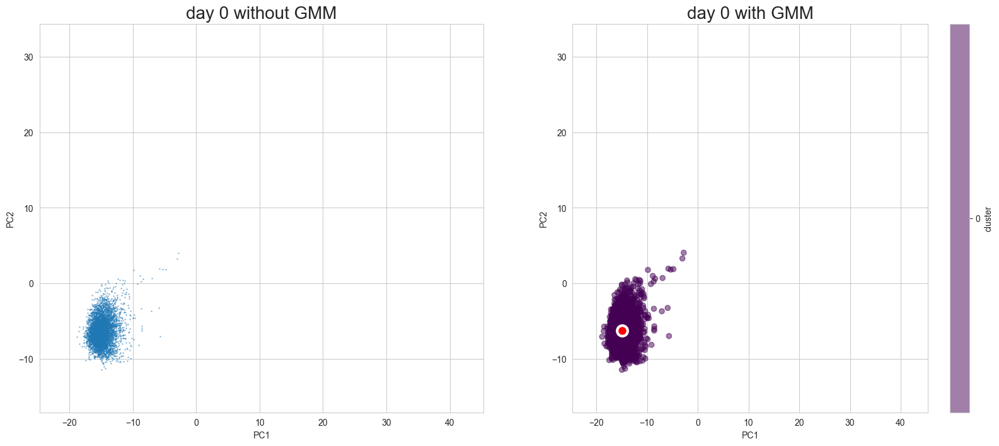

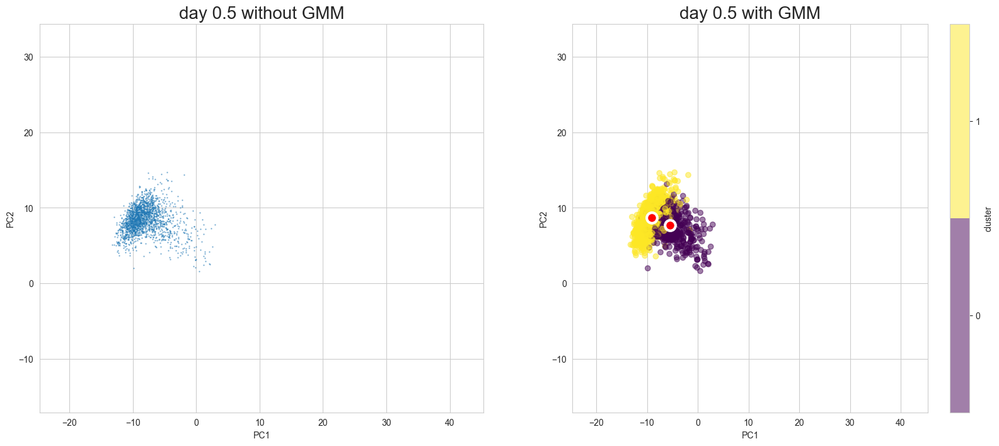

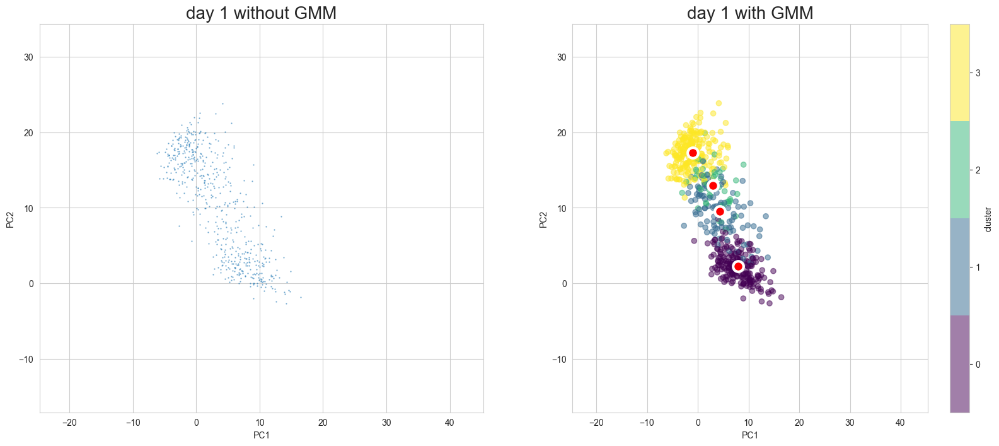

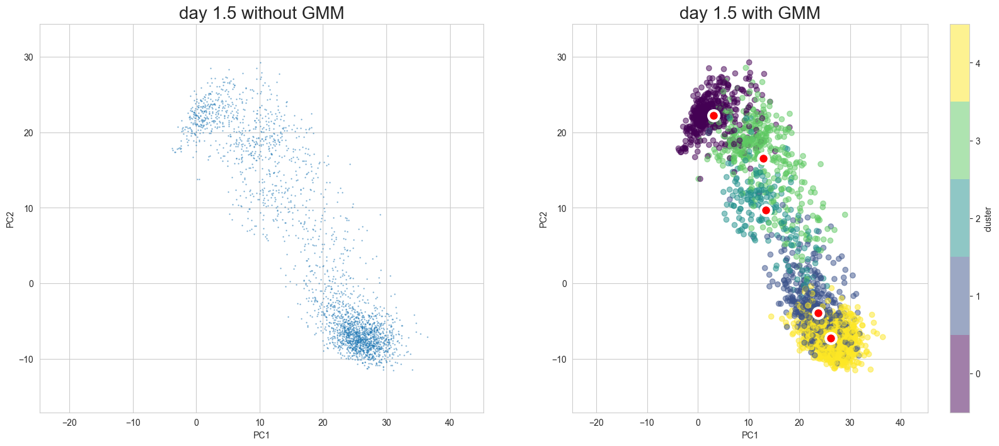

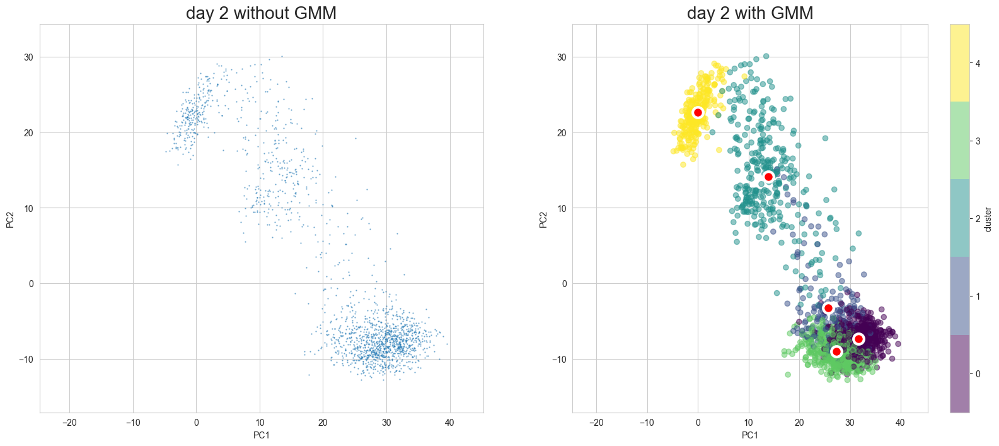

In [276]:
scegot.plot_gmm_predictions(
    plot_gmm_means=True,
    figure_titles_without_gmm=[f"{name} without GMM" for name in DAY_NAMES],
    figure_titles_with_gmm=[f"{name} with GMM" for name in DAY_NAMES],
    cmap="viridis",
    save=True,
    save_paths=[f"./output/library/PCA_GMM_figure_{name}.png" for name in DAY_NAMES],
)

### UMAP ver.

In [272]:
%%time
scegot.umap_n_components = UMAP_N_COMPONENTS
scegot.umap_n_neighbors = UMAP_N_NEIGHBORS
X_2, umap_model = scegot.apply_umap(random_state=RANDOM_STATE)

CPU times: user 5 µs, sys: 4 µs, total: 9 µs
Wall time: 10 µs


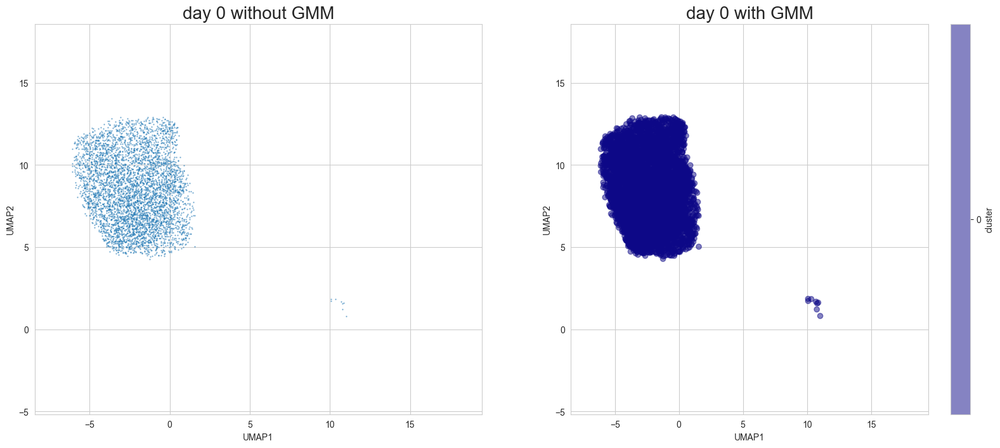

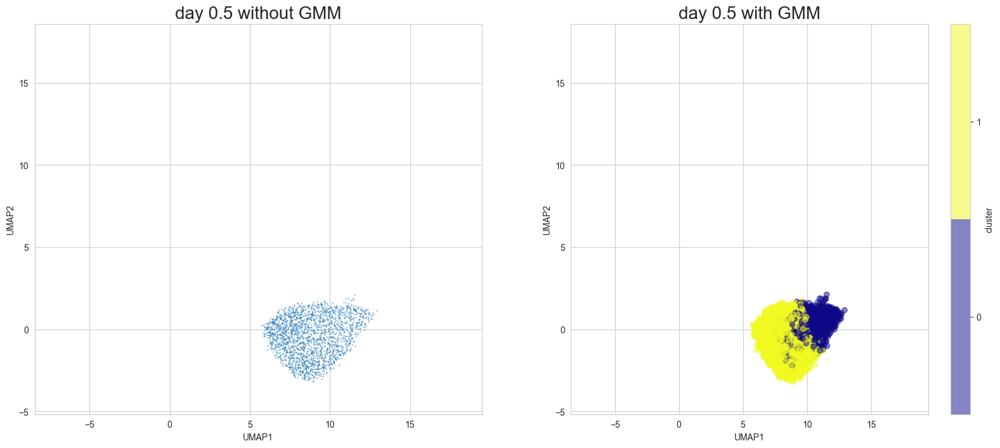

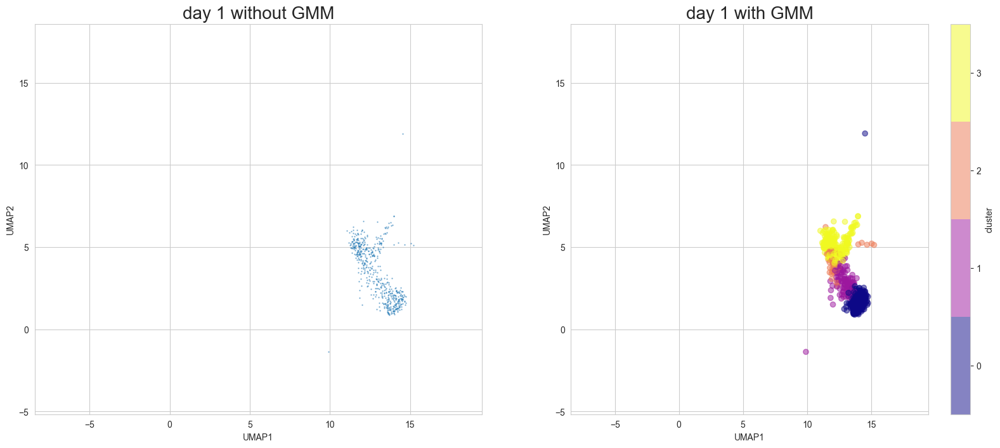

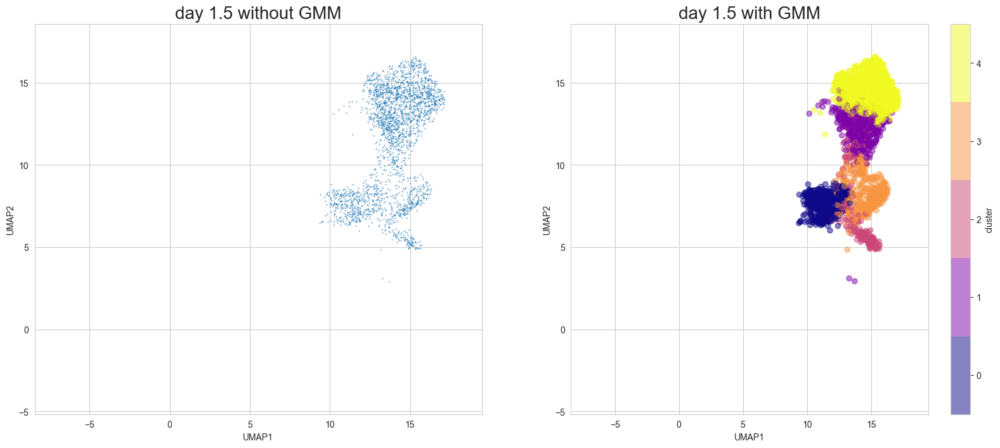

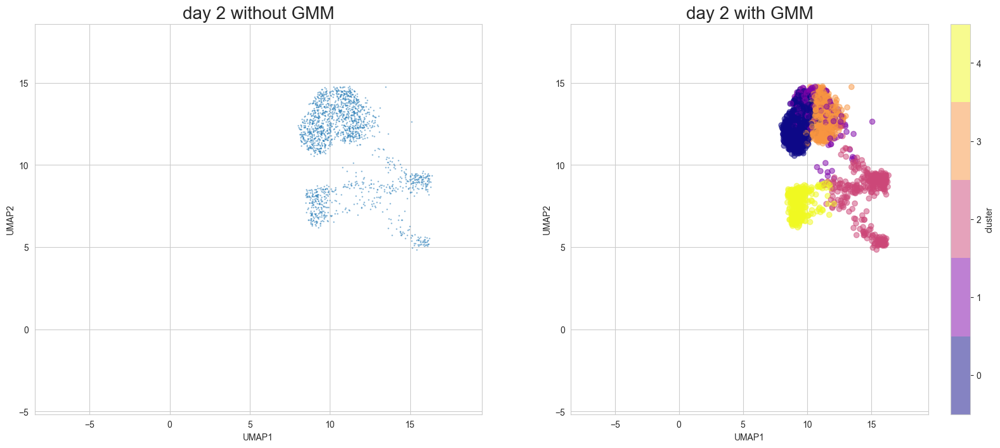

In [277]:
scegot.plot_gmm_predictions(
    mode="UMAP",
    figure_titles_without_gmm=[f"{name} without GMM" for name in DAY_NAMES],
    figure_titles_with_gmm=[f"{name} with GMM" for name in DAY_NAMES],
    cmap="plasma",
    save=True,
    save_paths=[f"./output/library/UMAP_GMM_figure_{name}.png" for name in DAY_NAMES],
)

## Cell State

### Movie

Interpolating between day 0 and day 0.5...


100%|██████████| 11/11 [00:03<00:00,  2.95it/s]


Interpolating between day 0.5 and day 1...


100%|██████████| 10/10 [00:06<00:00,  1.56it/s]


Interpolating between day 1 and day 1.5...


100%|██████████| 10/10 [00:14<00:00,  1.46s/it]


Interpolating between day 1.5 and day 2...


100%|██████████| 10/10 [00:19<00:00,  1.97s/it]


Creating animation...


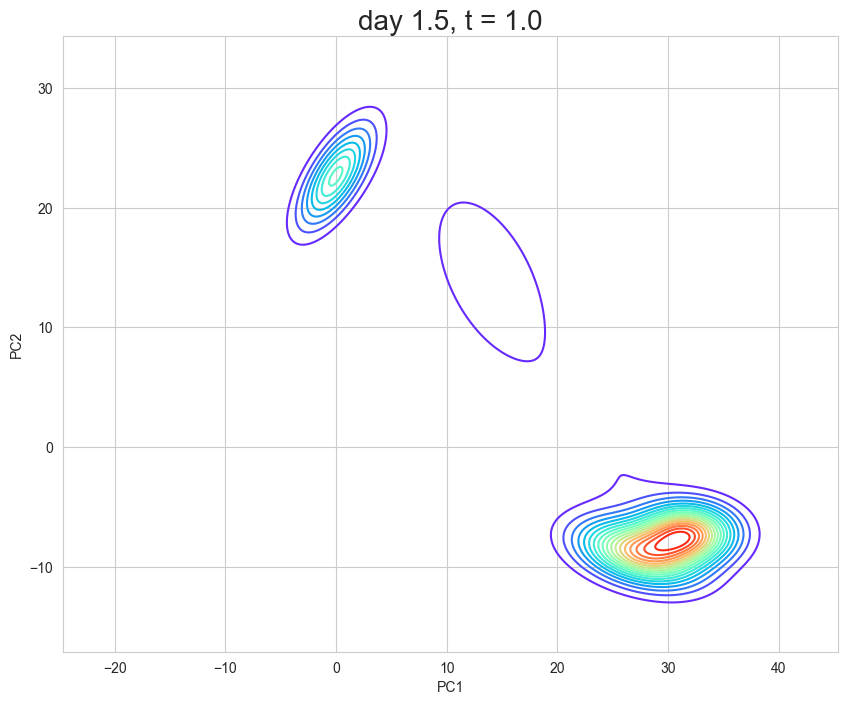

In [14]:
scegot.animate_cell_state(
    cmap="rainbow",
    save=True,
    save_path="./output/library/cell_state_video.gif",
)

### Graph

In [289]:
cluster_names = scegot.generate_cluster_names_with_day()

#### PCA ver.

In [290]:
cluster_names

[['day 0-0'],
 ['day 0.5-0', 'day 0.5-1'],
 ['day 1-1', 'day 1-0', 'day 1-3', 'day 1-2'],
 ['day 1.5-4', 'day 1.5-2', 'day 1.5-0', 'day 1.5-1', 'day 1.5-3'],
 ['day 2-0', 'day 2-4', 'day 2-3', 'day 2-1', 'day 2-2']]

In [238]:
G = scegot.make_cell_state_graph(cluster_names)
scegot.plot_cell_state_graph(
    G,
    cluster_names,
    tf_gene_names,
    save=True,
    save_path="./output/library/cell_state_graph_PCA.png",
)

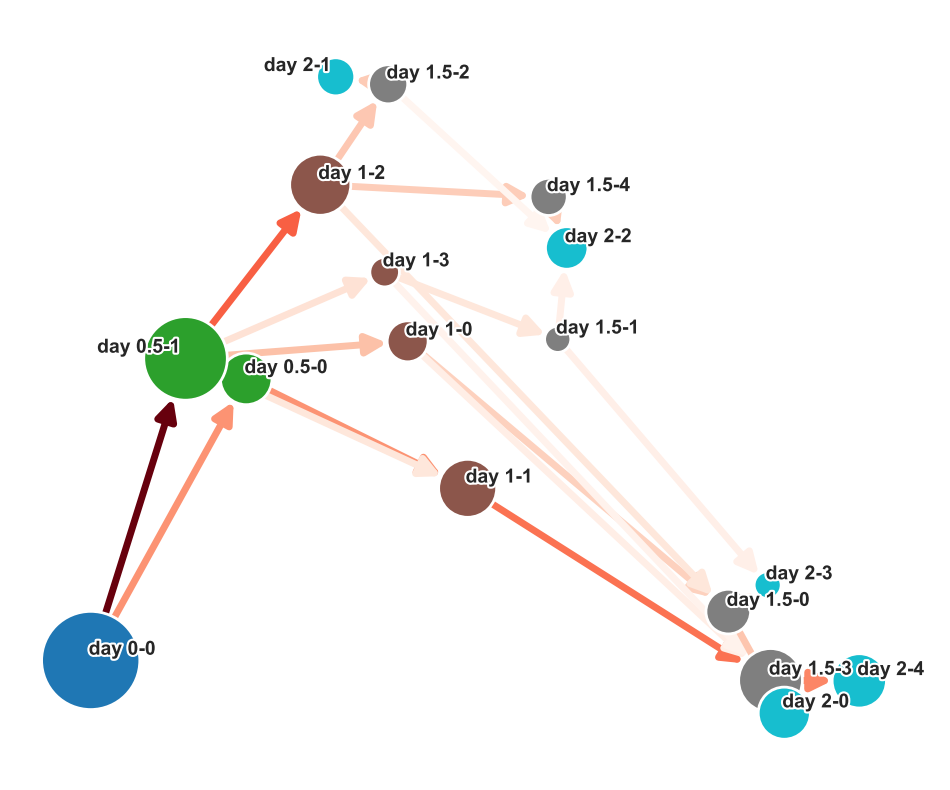

In [17]:
G = scegot.make_cell_state_graph(cluster_names)
scegot.plot_simple_cell_state_graph(
    G,
    save=True,
    save_path="./output/library/simple_cell_state_graph.png",
)

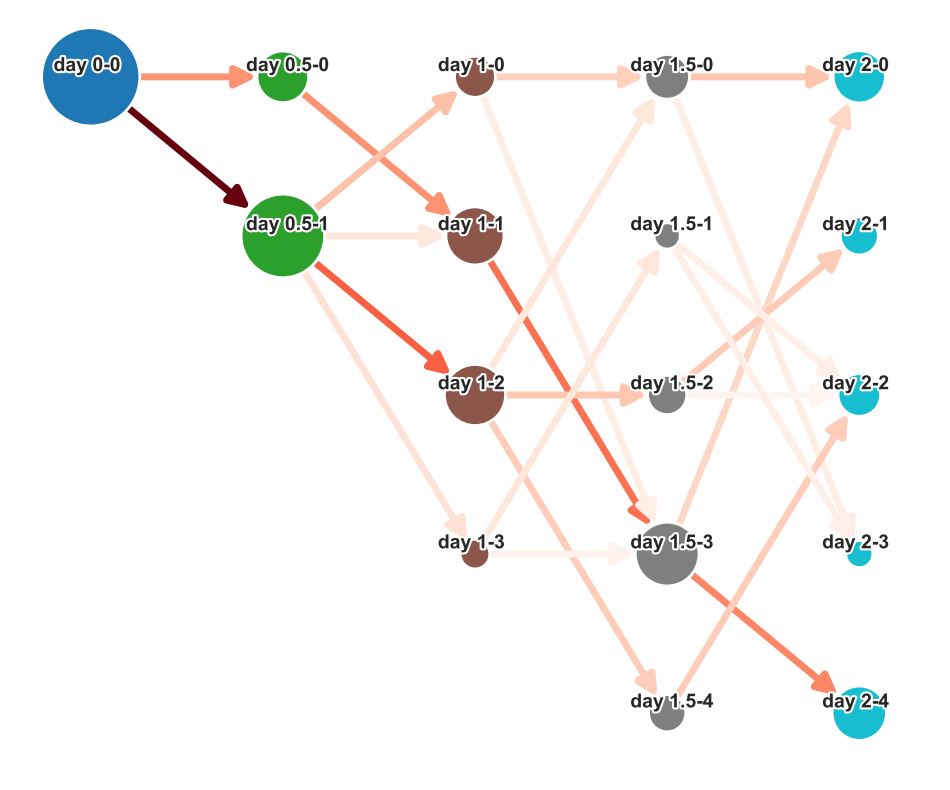

In [18]:
G = scegot.make_cell_state_graph(cluster_names)
scegot.plot_simple_cell_state_graph(
    G,
    plot_type="hierarchy",
    save=True,
    save_path="./output/library/simple_cell_state_graph_align.png",
)

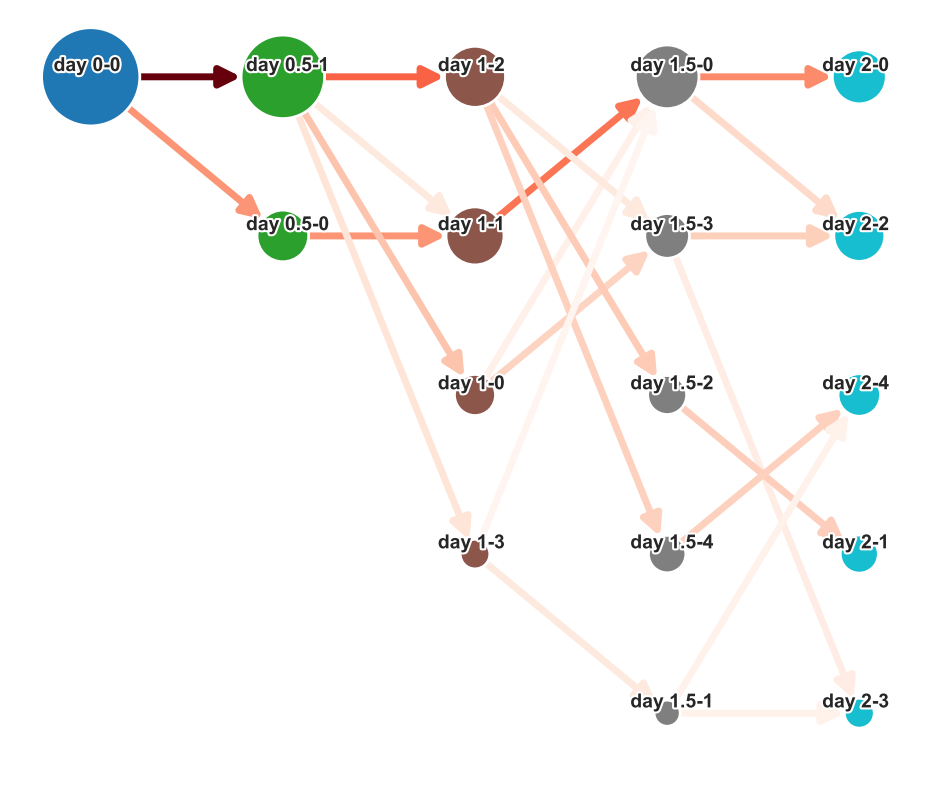

In [237]:
G = scegot.make_cell_state_graph(cluster_names)
scegot.plot_simple_cell_state_graph(
    G,
    plot_type="hierarchy",
    order="weight",
    save=True,
    save_path="./output/library/simple_cell_state_graph_align_weight.png",
)

#### UMAP ver.

In [19]:
G_umap = scegot.make_cell_state_graph(cluster_names, mode="umap")
scegot.plot_cell_state_graph(
    G_umap,
    cluster_names,
    tf_gene_names,
    save=True,
    save_path="./output/library/cell_state_graph_UMAP.png",
)

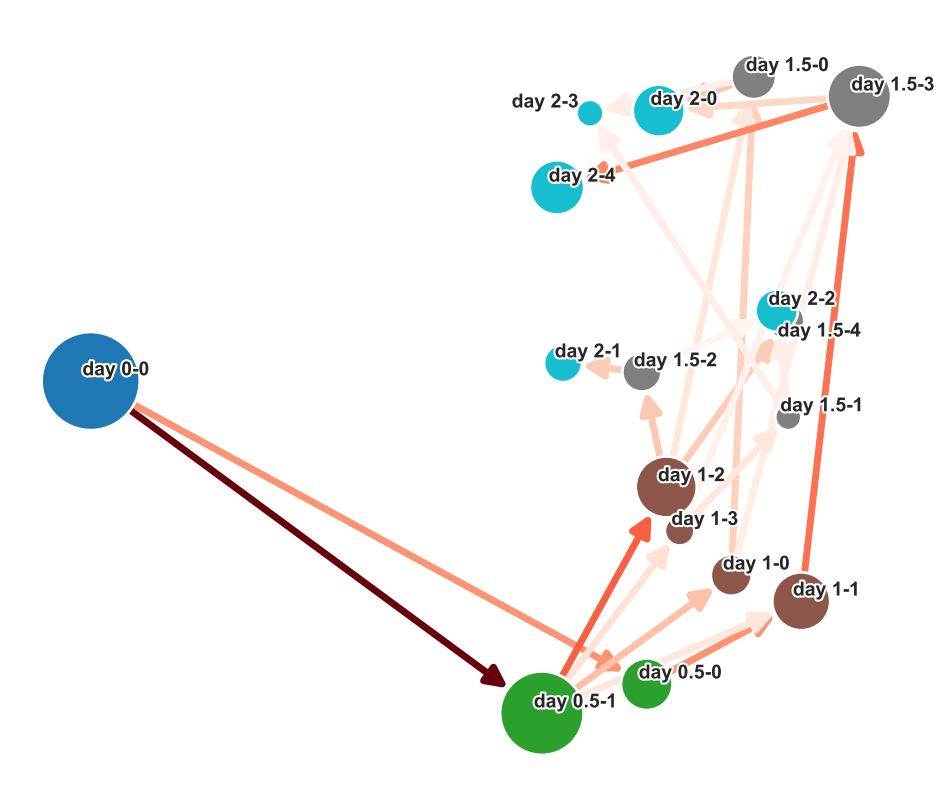

In [20]:
G_umap = scegot.make_cell_state_graph(cluster_names, mode="umap")
scegot.plot_simple_cell_state_graph(
    G_umap,
    save=True,
    save_path="./output/library/simple_cell_state_graph_UMAP.png",
)

## Fold Change

In [21]:
scegot.plot_fold_change(
    cluster_names,
    tf_gene_names,
    "day 0.5-0",
    "day 0.5-1",
    threshold=1.0,
    save=True,
    save_path="./output/library/fold_change.png",
)

## Pathway

In [22]:
# selected_genes = ['HAND1','FOXF1','MESP1','EOMES']
pathway_names = [
    "day 0-0",
    "day 0.5-1",
    "day 1-1",
    "day 1.5-4",
    "day 2-2",
]
selected_genes = ["NANOG", "SOX17", "TFAP2C", "NKX1-2"]
scegot.plot_pathway_gene_expressions(
    cluster_names,
    tf_gene_names,
    pathway_names,
    selected_genes,
    save=True,
    save_path="./output/library/pathway_gene_expressions.png",
)

## Features of single gene

### PCA ver.

In [23]:
gene_name = "NKX1-2"
scegot.plot_pathway_single_gene_2d(
    gene_name,
    save=True,
    save_path="./output/library/single_gene_2d.png",
)

In [24]:
scegot.plot_pathway_single_gene_3d(
    gene_name,
    save=True,
    save_path="./output/library/single_gene_3d.html",
)

### UMAP ver.

In [25]:
gene_name = "NKX1-2"
scegot.plot_pathway_single_gene_2d(gene_name, mode="UMAP")

## Interpolation

### PCA ver.

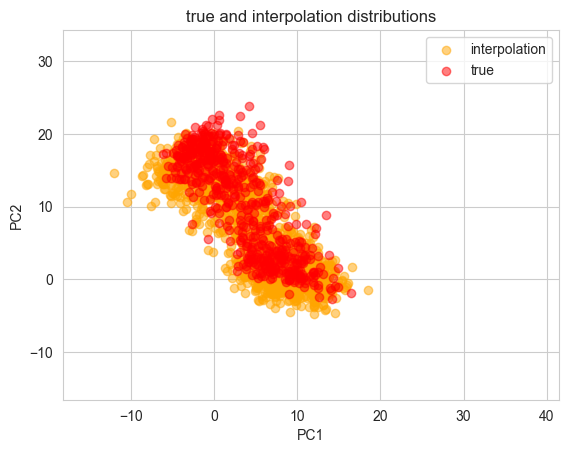

<Figure size 640x480 with 0 Axes>

In [26]:
scegot.plot_true_and_interpolation_distributions(
    2,
    plot_source_and_target=False,
    alpha_true=0.5,
    save=True,
    save_path="./output/library/true_interpolation_distributions_without_source_target.png",
)

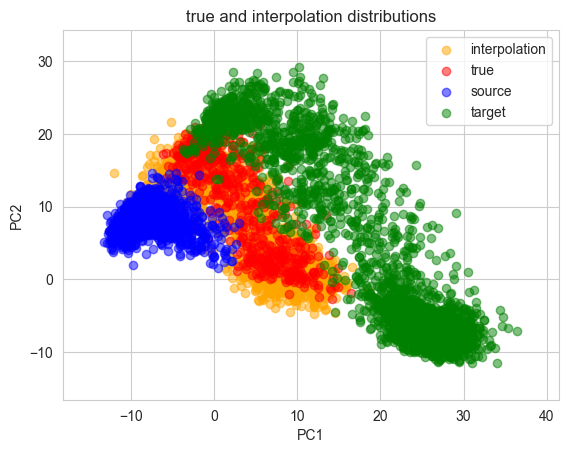

<Figure size 640x480 with 0 Axes>

In [27]:
scegot.plot_true_and_interpolation_distributions(
    2,
    alpha_true=0.5,
    save=True,
    save_path="./output/library/true_interpolation_distributions.png",
)

Interpolating between day 0 and day 0.5...


100%|██████████| 11/11 [00:00<00:00, 14.43it/s]


Interpolating between day 0.5 and day 1...


100%|██████████| 10/10 [00:01<00:00,  9.24it/s]


Interpolating between day 1 and day 1.5...


100%|██████████| 10/10 [00:01<00:00,  7.00it/s]


Interpolating between day 1.5 and day 2...


100%|██████████| 10/10 [00:01<00:00,  6.59it/s]


Creating animation...


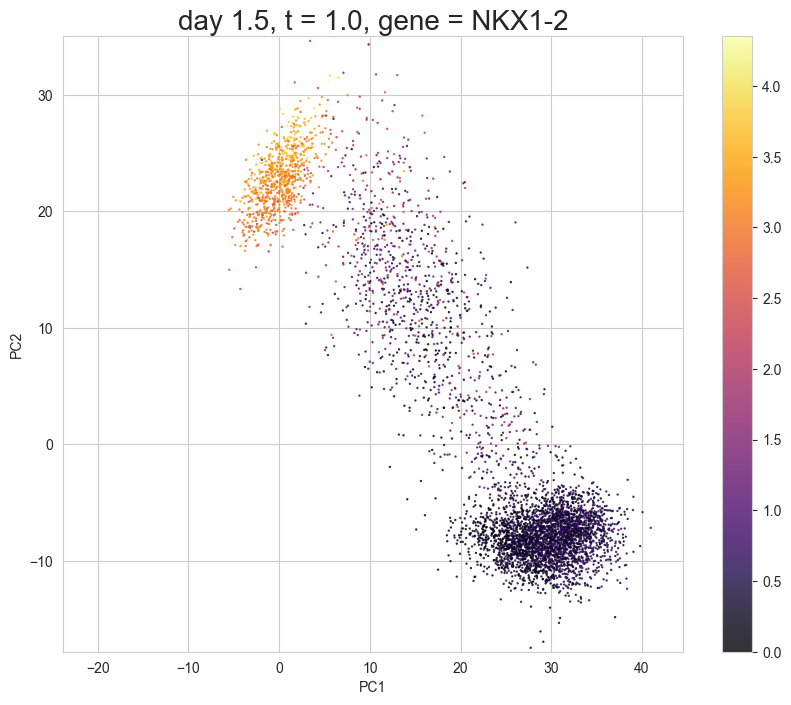

In [28]:
target_gene = "NKX1-2"
scegot.animate_interpolation(
    target_gene,
    interpolate_interval=11,
    cmap="inferno",
    save=True,
    save_path="./output/library/interpolation_video.gif",
)

### umap ver.

Transforming interpolated data with UMAP...


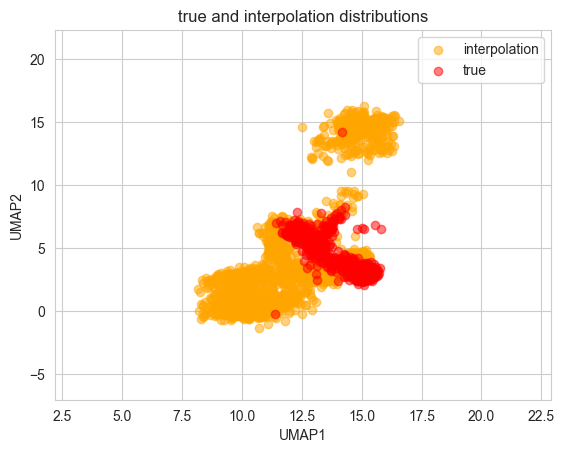

<Figure size 640x480 with 0 Axes>

In [29]:
scegot.plot_true_and_interpolation_distributions(
    2,
    plot_source_and_target=False,
    alpha_true=0.5,
    mode="umap",
    save=True,
    save_path="./output/library/true_interpolation_distributions_without_source_target_umap.png",
)

Transforming interpolated data with UMAP...


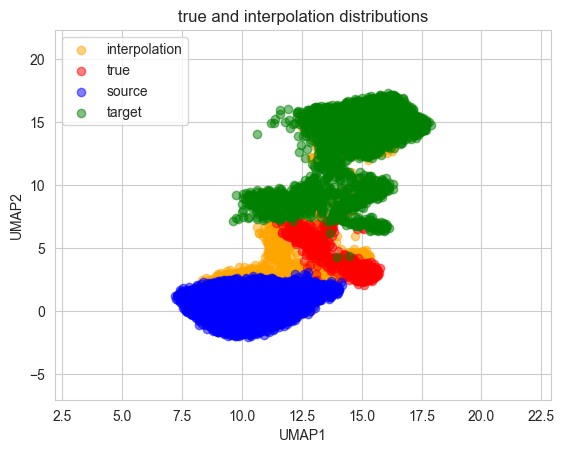

<Figure size 640x480 with 0 Axes>

In [30]:
scegot.plot_true_and_interpolation_distributions(
    2,
    alpha_true=0.5,
    mode="umap",
    save=True,
    save_path="./output/library/true_interpolation_distributions_umap.png",
)

Interpolating between day 0 and day 0.5...


100%|██████████| 11/11 [05:22<00:00, 29.35s/it]


Interpolating between day 0.5 and day 1...


100%|██████████| 10/10 [04:43<00:00, 28.32s/it]


Interpolating between day 1 and day 1.5...


100%|██████████| 10/10 [04:44<00:00, 28.46s/it]


Interpolating between day 1.5 and day 2...


100%|██████████| 10/10 [04:44<00:00, 28.45s/it]


Creating animation...


CPU times: user 20min 21s, sys: 26.6 s, total: 20min 48s
Wall time: 19min 41s


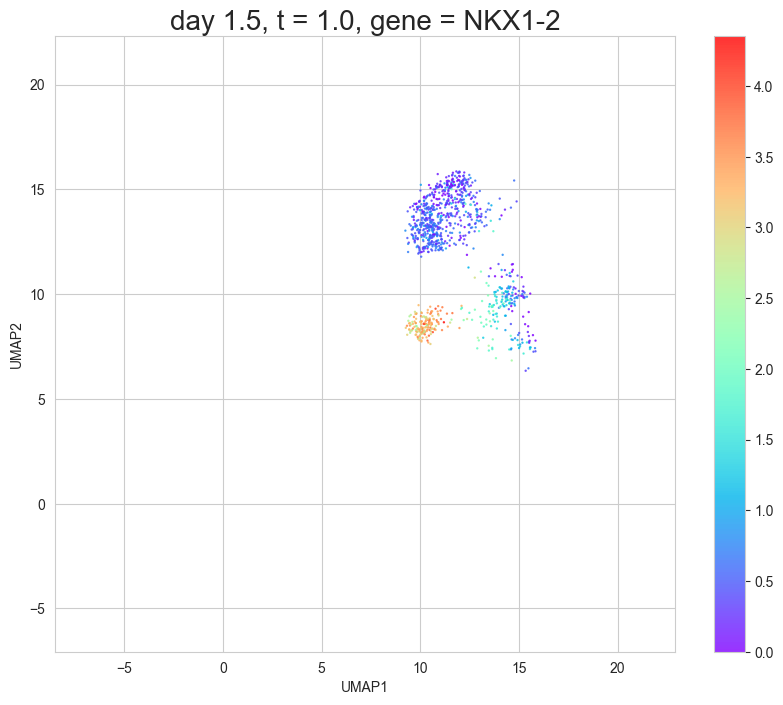

In [31]:
%%time
target_gene = "NKX1-2"
scegot.animate_interpolation(
    target_gene,
    interpolate_interval=11,
    n_samples=1000,
    mode="umap",
    save=True,
    save_path="./output/library/interpolation_video_umap.gif",
)

## Cell velocity

### PCA ver.

In [298]:
velocities = scegot.calculate_cell_velocities()

Calculating cell velocities between each day...


100%|██████████| 4/4 [00:05<00:00,  1.43s/it]


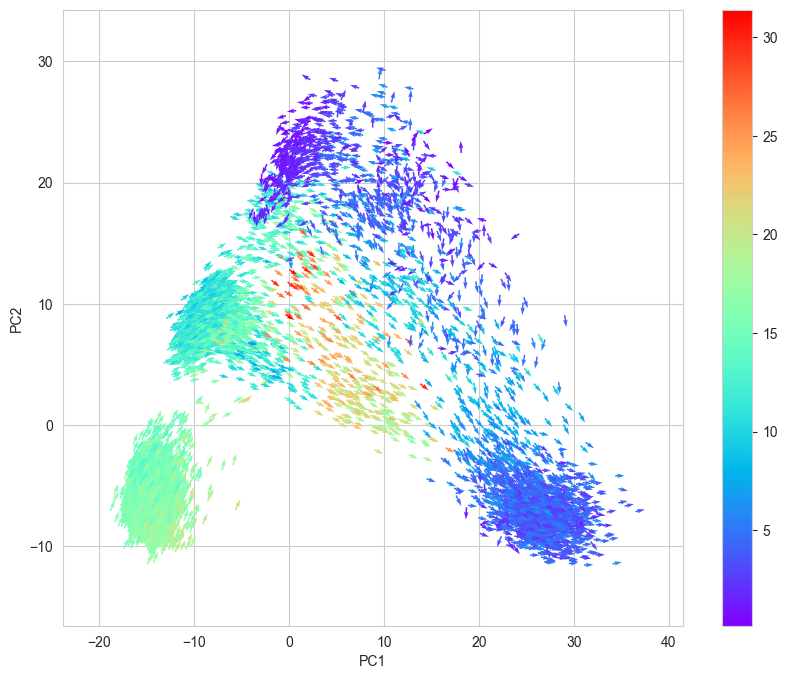

<Figure size 640x480 with 0 Axes>

In [299]:
scegot.plot_cell_velocity(
    velocities,
    cmap="rainbow",
    save=True,
    save_path="./output/library/cell_velocity_PCA.png",
)

In [300]:
cluster_names = scegot.generate_cluster_names_with_day()
cluster_names

[['day 0-0'],
 ['day 0.5-0', 'day 0.5-1'],
 ['day 1-1', 'day 1-0', 'day 1-3', 'day 1-2'],
 ['day 1.5-4', 'day 1.5-2', 'day 1.5-0', 'day 1.5-1', 'day 1.5-3'],
 ['day 2-0', 'day 2-4', 'day 2-3', 'day 2-1', 'day 2-2']]

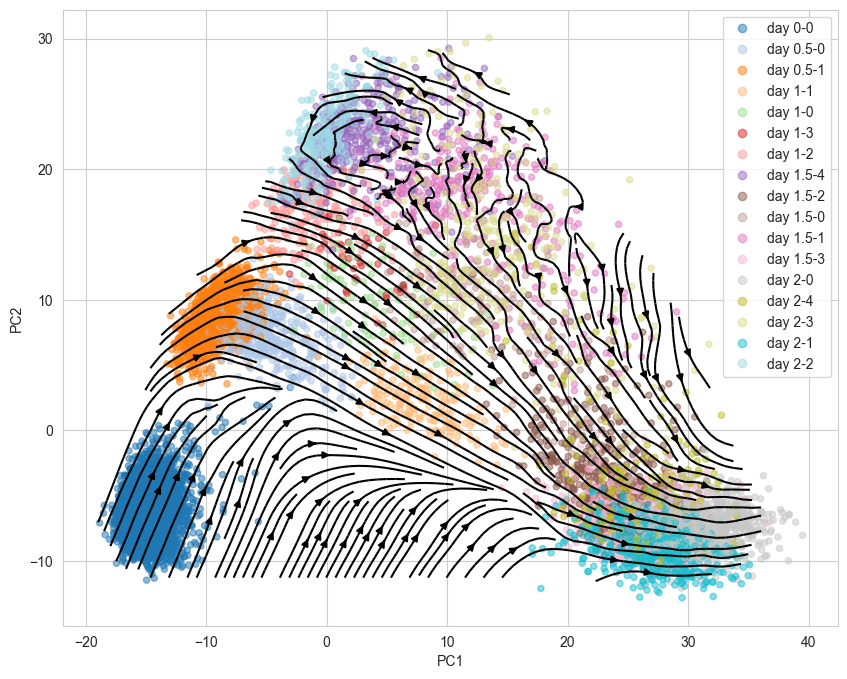

<Figure size 640x480 with 0 Axes>

In [301]:
scegot.plot_interpolation_of_cell_velocity(
    velocities,
    cluster_names=list(itertools.chain.from_iterable(cluster_names)),
    cmap="tab20",
    save=True,
    save_path="./output/library/cell_velocity_interpolation_gmm_clusters_all_days.png",
)

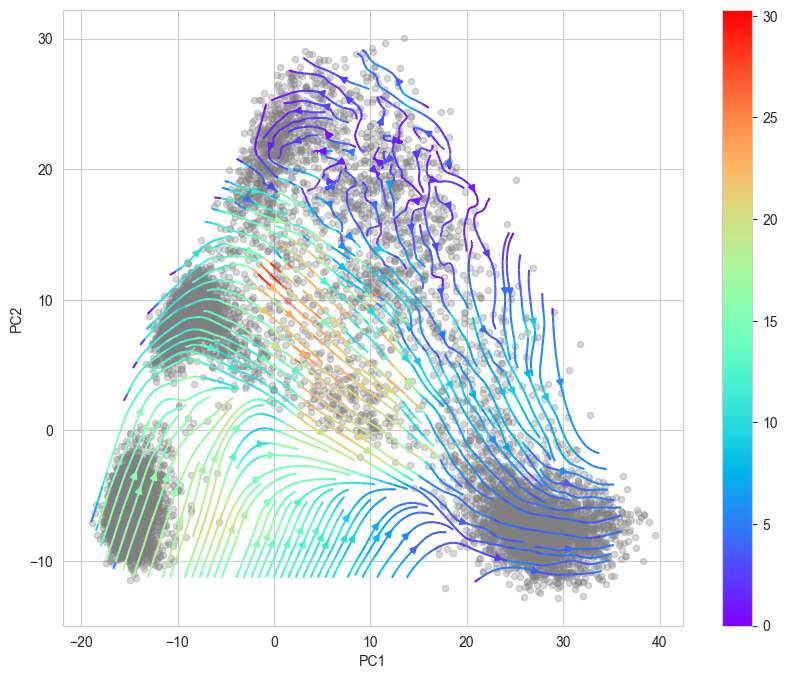

<Figure size 640x480 with 0 Axes>

In [36]:
scegot.plot_interpolation_of_cell_velocity(
    velocities,
    color_streams=True,
    color_points=None,
    cmap="rainbow",
    save=True,
    save_path="./output/library/cell_velocity_interpolation_all_days.png",
)

### UMAP ver.

In [37]:
%%time
velocities_umap = scegot.calculate_cell_velocities(mode="umap")

Calculating cell velocities between each day...


100%|██████████| 4/4 [05:19<00:00, 79.84s/it] 

CPU times: user 5min 38s, sys: 5.86 s, total: 5min 44s
Wall time: 5min 19s


In [79]:
%%time
velocities_umap_new = scegot.calculate_cell_velocities(mode="umap")

Calculating cell velocities between each day...


100%|██████████| 4/4 [05:19<00:00, 79.84s/it] 

CPU times: user 5min 36s, sys: 5.26 s, total: 5min 41s
Wall time: 5min 19s


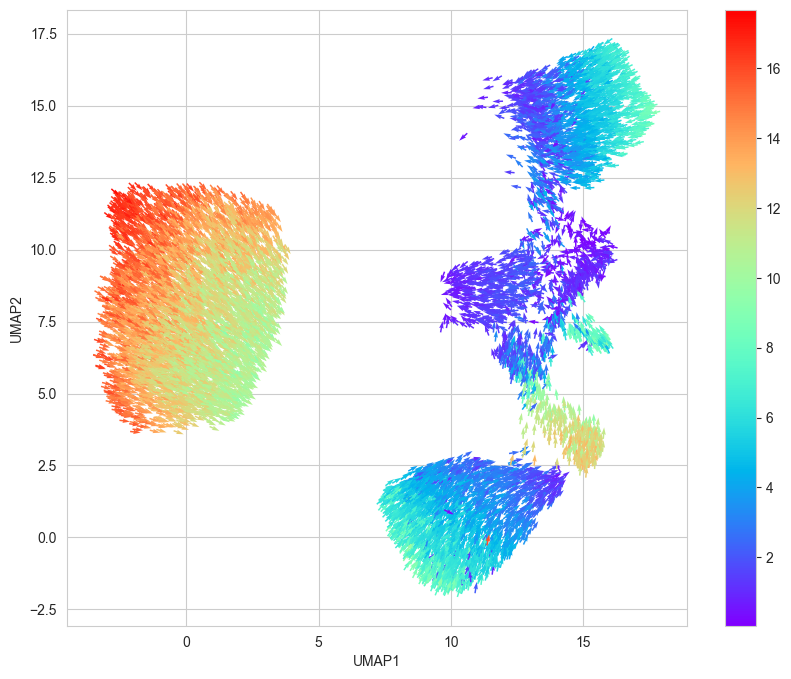

CPU times: user 686 ms, sys: 9.58 ms, total: 696 ms
Wall time: 279 ms


<Figure size 640x480 with 0 Axes>

In [82]:
%%time
scegot.plot_cell_velocity(
    velocities_umap_new,
    mode="umap",
    cmap="rainbow",
    save=True,
    save_path="./output/library/cell_velocity_umap.png",
)

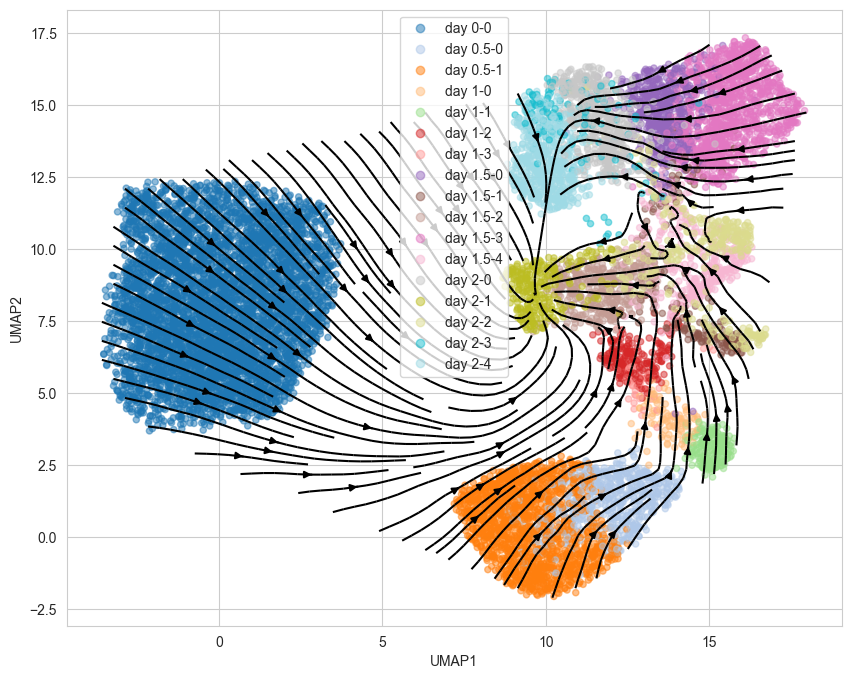

<Figure size 640x480 with 0 Axes>

In [83]:
scegot.plot_interpolation_of_cell_velocity(
    velocities_umap_new,
    mode="umap",
    cluster_names=list(itertools.chain.from_iterable(cluster_names)),
    cmap="tab20",
    save=True,
    save_path="./output/library/cell_velocity_interpolation_UMAP_gmm_clusters_all_days.png",
)

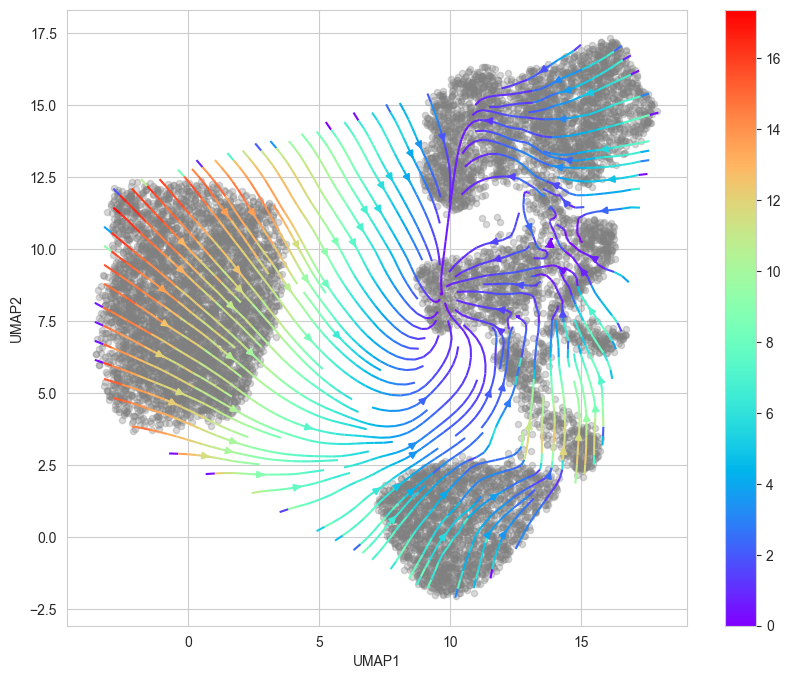

<Figure size 640x480 with 0 Axes>

In [84]:
scegot.plot_interpolation_of_cell_velocity(
    velocities_umap_new,
    mode="umap",
    color_streams=True,
    color_points=None,
    cmap="rainbow",
    save=True,
    save_path="./output/library/cell_velocity_interpolation_UMAP_all_days.png",
)

## GRN

In [41]:
%%time
GRNs, ridgeCVs = scegot.calculate_grns()

Calculating GRNs between each day...


100%|██████████| 4/4 [00:10<00:00,  2.67s/it]

CPU times: user 1min 3s, sys: 3.28 s, total: 1min 6s
Wall time: 10.7 s


alpha = 0.11288378916846889


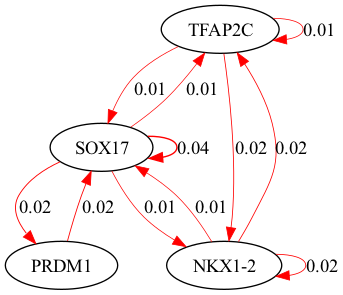

alpha = 37.92690190732246


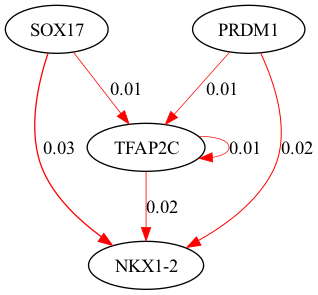

alpha = 23.357214690901213


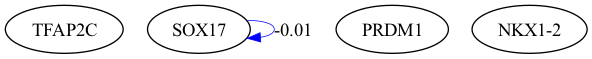

alpha = 100.0


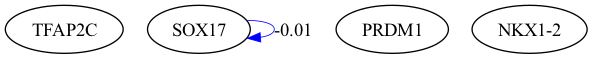

In [42]:
selected_genes = ["TFAP2C", "SOX17", "PRDM1", "NKX1-2"]
scegot.plot_grn_graph(
    GRNs,
    ridgeCVs,
    selected_genes,
    thresh=0.01,
    save=True,
    save_paths=[
        f"./output/library/GRN_{DAY_NAMES[i]}_to_{DAY_NAMES[i + 1]}.png"
        for i in range(len(DAY_NAMES) - 1)
    ],
)

## Waddington Landscape

In [48]:
%%time
Wpotential, F_all = scegot.calculate_waddington_potential()

Calculating F between each day...


100%|██████████| 4/4 [01:17<00:00, 19.46s/it]


Applying knn ...
Computing kernel ...
CPU times: user 7min 28s, sys: 1min 3s, total: 8min 32s
Wall time: 1min 20s


In [49]:
%%time
Wpotential_umap, F_all_umap = scegot.calculate_waddington_potential(knn_mode="umap")

Calculating F between each day...


100%|██████████| 4/4 [01:03<00:00, 15.87s/it]


Applying knn ...
Computing kernel ...
CPU times: user 6min 10s, sys: 1min 10s, total: 7min 21s
Wall time: 1min 5s


In [44]:
scegot.plot_waddington_potential(Wpotential)

In [52]:
gene_name = "NKX1-2"
scegot.plot_waddington_potential(
    Wpotential,
    gene_name,
    save=True,
    save_path="./output/library/waddington_potential.html",
)

In [50]:
gene_name = "NKX1-2"
scegot.plot_waddington_potential(
    Wpotential_umap,
    gene_name,
)

In [55]:
scegot.plot_waddington_potential_surface(
    Wpotential,
    save=True,
    save_path="./output/library/waddington_potential_surface.html",
)

In [63]:
scegot.plot_waddington_potential_surface(
    Wpotential_umap,
    save=False,
)